## CS 484/684 Computational Vision Final Project 10 - Image Inpainting

### Xiangru Tan x56tan@uwaterloo.ca

### The high-level goal for this project is to inpaint. To be more specific, if we are given some image that are missing some part (for example, an corner), how do we get the complete image back? This motivated this project.  Since designing a network model for inpainting has a number of challanges. I simplified the project by assuming that the holes are always rectangular, and that they are always in the center and have the same size.

### I designed three ways to do this inpaint. The first is Deep Image Prior, the second is to use L2 losses and minimizing reconstruction error (which is called Auto Encoder Decoder), the last method is to try Generative adversarial network (GAN). Detailed methodology and ideas will be discussed below. 

# Code Libraries

warnings: To ignore all warnings.

numpy and PIL: Used for basic image manipulations.

torch and copy: Used to build neural networks.

**voc.py**: a self created code libraries to download and process (make a hole in the center) the images for both training and validation set.

**trans.py**: a self created code libraries to store all the transformation and ploting function needed. More detail below on the 'Transformation bank' section.

**nnmodels.py**: a self created code libraries to store all the neural networks needed. More detail below on the 'A look at the Networks' section.

In [1]:
# To ignore all warnings
import warnings
warnings.filterwarnings('ignore')

# Python Libraries
import copy

# Importing essential libraries for basic image manipulations.
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# We import some of the main PyTorch and TorchVision libraries used for HW4.
# Detailed installation instructions are here: https://pytorch.org/get-started/locally/
# That web site should help you to select the right 'conda install' command to be run in 'Anaconda Prompt'.
# In particular, select the right version of CUDA. Note that prior to installing PyTorch, you should  
# install the latest driver for your GPU and CUDA (9.2 or 10.1), assuming your GPU supports it. 
# For more information about pytorch refer to 
# https://pytorch.org/docs/stable/nn.functional.html
# https://pytorch.org/docs/stable/data.html.
# and https://pytorch.org/docs/stable/torchvision/transforms.html
import torch
import torch.nn.functional as F
from torch import nn
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import torchvision.transforms.functional as tF

# I ovewrited the given voc.py from A5 and added a new class VOCImpaint_midhole to deal with the Impainting problem, please see detailed documentation in the file.
from mylibs.voc import VOCImpaint_midhole

# The transformation bank, please see detailed documentation below or in the file.
from mylibs.trans import *

# The model bank, please see detailed documentation below or in the file.
from mylibs.nnmodels import MyNet_DIP, MyUNet, MyDis

# Set the global variables

In [2]:
%matplotlib inline

# Set some global constant for this project
USE_GPU = True
HOLE_SIZE = 50

# Set the bathc size to 4
TRAIN_BATCH_SIZE = 4

# NUM_WORKERS must be 0 for Windows
NUM_WORKERS = 0

# A look at the dataset

### We used the same dataset as the one from A5 which is the PASCAL dataset, and we did a little modification to it so it suites the purpose of this assignment. 
### Mark $download$ = $True$ to download the datset first, mark $make\_hole$ = $True$ to gernrate the holed version of the PASCAL dataset with size $size$. If you are running this for the first time, set both parameter to True.
### The PASCAL dataset is processed to have a hole in the center with size 50 (default).

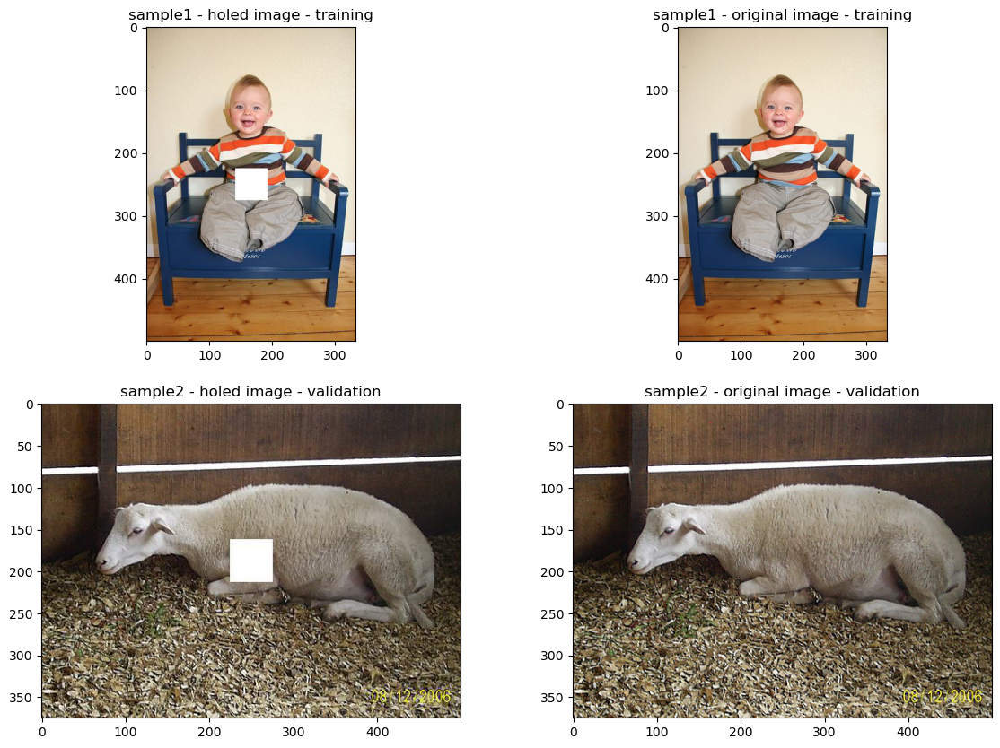

In [3]:
DATASET_PATH = 'datasets'  

# We picked two photos to have a look at the training and validation set
# Mark download = True to download the datset first, mark make_hole = True to gernrate the holed version of the PASCAL dataset. If you are running this for the first time, set both parameter to True.

sample1 = VOCImpaint_midhole(DATASET_PATH, image_set='train', make_hole = False, size = HOLE_SIZE, download=False)[100]
sample2 = VOCImpaint_midhole(DATASET_PATH, image_set='val', make_hole = False, size = HOLE_SIZE, download=False)[20]

img1, target1 = sample1
img2, target2 = sample2

fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2,2,1)
plt.title('sample1 - holed image - training')
ax1.imshow(img1)
ax2 = fig.add_subplot(2,2,2)
plt.title('sample1 - original image - training')
ax2.imshow(target1)
ax3 = fig.add_subplot(2,2,3)
plt.title('sample2 - holed image - validation')
ax3.imshow(img2)
ax4 = fig.add_subplot(2,2,4)
plt.title('sample2 - original image - validation')
ax4.imshow(target2)

# Transformation bank

* class **JointToTensor**: Transform the input image to tensor type.

* class **JointCenterCrop**: Cut the image in the center with size size.

* class **JointResizeCenterCrop**: Cut the image in the center with size size. If the image is not big enough, first resize it.

* class **JointRandomResizeCrop**: Resize by scale between minimum_scale and maximum_scale, then crop a random location and resize.

* class **JointNormalize**: Normalize the image based on mean and std.

* class **JointCompose**: Compose the input transformation.
    
* function **InvNormalize(img, mean, std)**: Inverse the image from normalized version back to original image.

* function **fix_img(hole_img, pre_img, hole_size)**: Fix the hole in the center of hole_img by adding the center of the pre_img back.

* function **plot_4(sample_img, sample_target, sample_output_O, hole_size, invnorm)**: Plot 4 image.
    1. sample_img,
    2. sample_target, 
    3. the output of nerwork forward run (sample_output_O),
    4. the fixed image by combining the center of the forward run back to sample_img
    if invnorm is set the True, we first do inverse norm for image 1 and 2, image 3 and 4 will always be inverse normed.

* function **plot_2(sample_img, sample_target, sample_output_O, hole_size, invnorm)**: Plot 2 image.
    1. sample_target,
    2. the fixed image by combining the center of the forward run back to sample_img
    if invnorm is set the True, we first do inverse norm for sample_target, image 2 will always be inverse normed.
    
* function **plot_compare(sample_target1, sample_output_O1, sample_target2, sample_output_O2, hole_size, invnorm)**: Plot 4 image.
    1. sample_target1, 
    2. the fixed image by combining the center of the forward run back to sample_img1, 
    3. sample_target2,
    4. the fixed image by combining the center of the forward run back to sample_img2
    if invnorm is set the True, we first do inverse norm for image 1 and 3, image 2 and 4 will always be inverse normed.

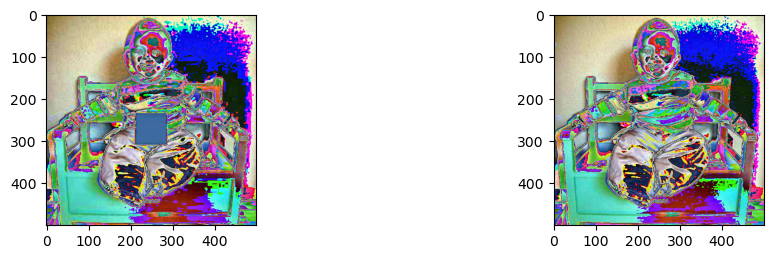

In [4]:
norm = ([0.485, 0.456, 0.406], 
        [0.229, 0.224, 0.225])

# testing
img, target = JointCompose((JointRandomResizeCrop(500, 0.5, 1),JointToTensor(),JointNormalize(*norm)))(*sample1)

img = tF.to_pil_image(img)
target = tF.to_pil_image(target)

fig = plt.figure(figsize=(12,6))
ax1 = fig.add_subplot(2,2,1)
ax1.imshow(img)
ax2 = fig.add_subplot(2,2,2)
ax2.imshow(target)

# A look at the Networks

### All the networks that will be used is listed below. possible photos needed! what network we are using for each model!

Net used for **Deep Image Prior**: MyNet_DIP

Net used for **Auto Encoder Decoder**: MyUNet

Net used for **GAN**: MyUNet, MyDis

### **MyNet_DIP**

<img src="images\MyNet_DIP.png"> 

This network it  exatly same as the one from A5. But when we are calculating the loss, we set the loss from the hole (which is the missing part) to be 0.

### **MyUNet**

<img src="images\MyUNet.png"> 

This is a customized reconstruct of the Unet. With some help from https://github.com/milesial/Pytorch-UNet.

### **MyDis**

This network it exatly same as Resnet18 excpet for the last layer we changed the fc layer to have only 1 clas (so only one channel).

# Deep Image Prior (DIP)

### We first use DIP method to do inpainting. The idea is that we believe that the sturcture of the network already contained enough information to do inpainting, so we don't do any other training, if we are given an imcomplete image, all we need is to adjust the parameter to fit the imcomplete image and then do a forward run to get the complete image.
### The method we used can be roughly describe as follows:
### 1. We design a network.
### 2. We train the network based on the input image with no other information, no true image, no other image, etc. When 'overfitting', we ignore the loss form the hole.
### 3. Then based on the "over trained" network, we do a forward path to get the DIP image.

### Some detailed methodology can be found from this nice article https://openaccess.thecvf.com/content_cvpr_2018/html/Ulyanov_Deep_Image_Prior_CVPR_2018_paper.html

### For DIP, we use the netwotk MyNet_DIP.

### We first define the optimizer and training function for this section.

In [5]:
def get_optimizer_DIP(net):
    optimizer = torch.optim.SGD(net.parameters(), lr=0.1)
    return optimizer

def train_DIP(train_loader, net, optimizer, loss_graph):
    
    for i, data in enumerate(train_loader):
                
        inputs, masks = data

        if USE_GPU:
            inputs, masks = inputs.cuda(), inputs.cuda() # Note here we don't give the original photo
            net = net.cuda()
            
        optimizer.zero_grad()
        loss,lfinal = net.forward(inputs, masks)
        loss.backward()
        optimizer.step()

        main_loss = loss.item()
        
        loss_graph.append(loss.item()) #Populate this list to graph the loss
        
    return main_loss, lfinal

### Then we perpare the data.

In [6]:
# Set the transformation
sanity_joint_transform_DIP = JointCompose((JointToTensor(),JointNormalize(*norm)))

sanity_data_train = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'train',
    transforms = sanity_joint_transform_DIP,
    sanity_check = 100
)

sanity_loader_train = DataLoader(sanity_data_train, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)

sanity_data_val = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'val',
    transforms = sanity_joint_transform_DIP,
    sanity_check = 20
)

sanity_loader_val = DataLoader(sanity_data_val, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)

### We first have a look at the untrained network and see how it works.

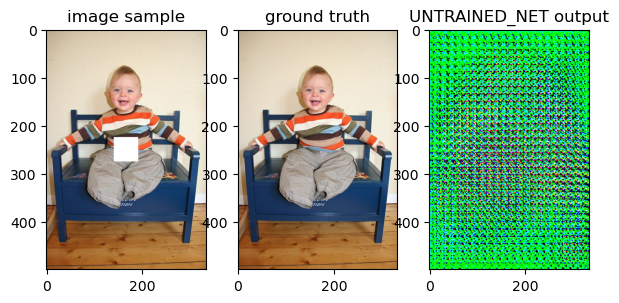

In [7]:
untrained_net = MyNet_DIP(50).eval()
sample_img, sample_target = JointToTensor()(*sample1)
untrained_output = untrained_net.forward(sample_img[None]).squeeze(0)

fig = plt.figure(figsize=(7,5))
ax = fig.add_subplot(1,3,1)
plt.title('image sample')
ax.imshow(sample1[0])
ax = fig.add_subplot(1,3,2)
plt.title('ground truth')
ax.imshow(sample1[1])
ax = fig.add_subplot(1,3,3)
plt.title('UNTRAINED_NET output')
ax.imshow(tF.to_pil_image(untrained_output))

### We train the two picked image using DIP.

Starting Training...
Epoch: 0 Loss: 1.8666232824325562
Epoch: 200 Loss: 0.39826640486717224
Epoch: 400 Loss: 0.2728967070579529
Epoch: 600 Loss: 0.20888352394104004
Epoch: 800 Loss: 0.15515528619289398
Epoch: 1000 Loss: 0.12620341777801514
Epoch: 1200 Loss: 0.11386924982070923
Epoch: 1400 Loss: 0.10638154298067093
Epoch: 1600 Loss: 0.09203695505857468
Epoch: 1800 Loss: 0.0859733521938324
Epoch: 1999 Loss: 0.08299052715301514
CPU times: total: 14min
Wall time: 3min 8s


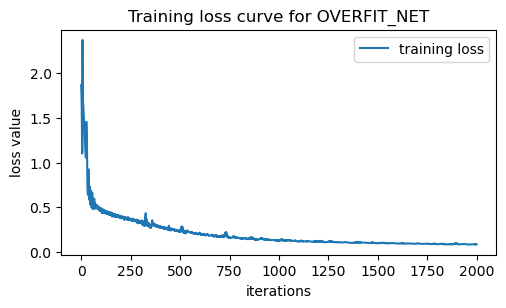

In [8]:
%%time
%matplotlib inline

# Get the net
overfit_net = copy.deepcopy(untrained_net)
# Set loss function for the net
overfit_net.criterion = nn.MSELoss(reduction = 'mean')
# Set the number of EPOCHS
EPOCH = 2000
# Switch to train mode
overfit_net.train()
# Get the optimizer
optimizer = get_optimizer_DIP(overfit_net)

loss_graph = []

fig = plt.figure(figsize=(6,3))
plt.subplots_adjust(bottom=0.2,right=0.85,top=0.95)
ax = fig.add_subplot(1,1,1)

print("Starting Training...")
for e in range(EPOCH):
    loss,lfinal = train_DIP(sanity_loader_train, overfit_net, optimizer, loss_graph)
    ax.clear()
    ax.set_xlabel('iterations')
    ax.set_ylabel('loss value')
    ax.set_title('Training loss curve for OVERFIT_NET')
    ax.plot(loss_graph, label='training loss')
    ax.legend(loc='upper right')
    fig.canvas.draw()
    if e % (EPOCH//10) == 0 or e == EPOCH - 1:
        print("Epoch: {} Loss: {}".format(e, loss))


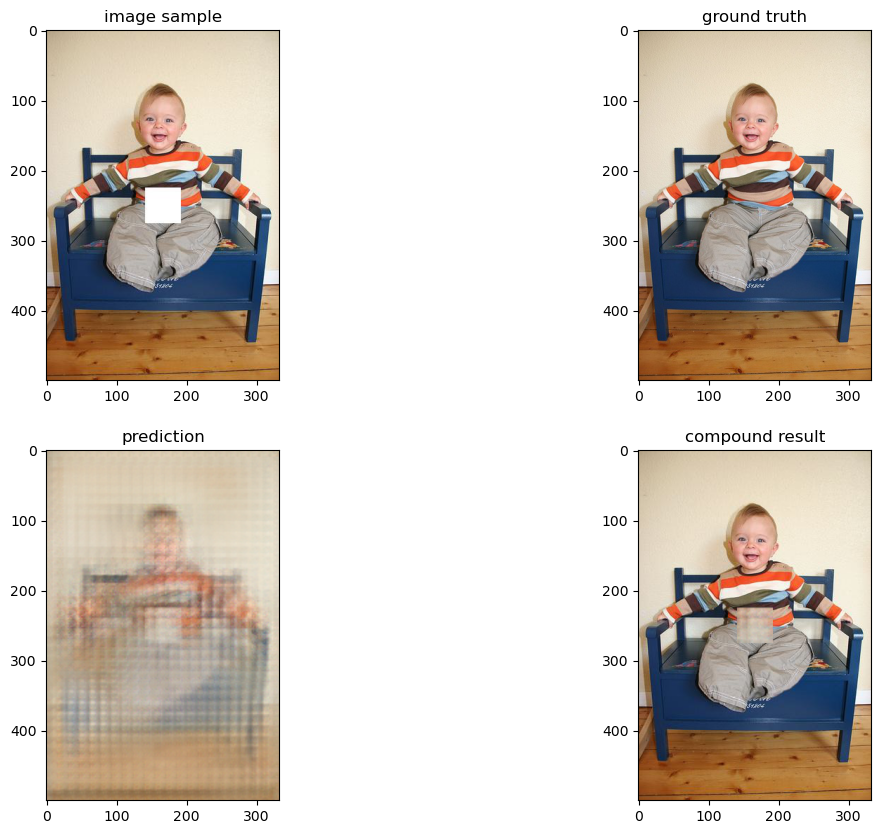

In [9]:
# Switch back to evaluation mode
overfit_net.eval()

sample_img1, sample_target1 = JointToTensor()(*sample1)
if USE_GPU:
    sample_img1 = sample_img1.cuda()
sample_output_O1 = overfit_net.forward(sample_img1[None]).squeeze(0)
# Plot!
plot_4(sample_img1, sample_target1, sample_output_O1, HOLE_SIZE)

Starting Training...
Epoch: 0 Loss: 1.0880255699157715
Epoch: 800 Loss: 0.33098104596138
Epoch: 1600 Loss: 0.2911922335624695
Epoch: 2400 Loss: 0.2605421245098114
Epoch: 3200 Loss: 0.23309606313705444
Epoch: 4000 Loss: 0.20739787817001343
Epoch: 4800 Loss: 0.19097618758678436
Epoch: 5600 Loss: 0.17662721872329712
Epoch: 6400 Loss: 0.16202834248542786
Epoch: 7200 Loss: 0.15228495001792908
Epoch: 7999 Loss: 0.14532899856567383
CPU times: total: 54min 45s
Wall time: 12min 15s


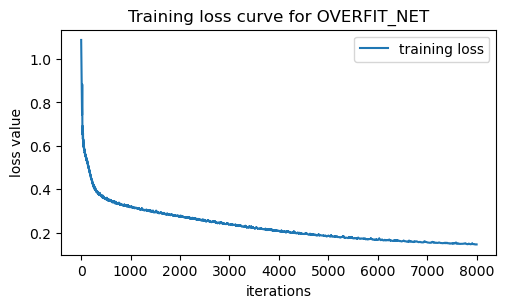

In [10]:
%%time
%matplotlib inline

# Get the net
overfit_net = copy.deepcopy(untrained_net)
# Set loss function for the net
overfit_net.criterion = nn.MSELoss(reduction = 'mean')
# Set the number of EPOCHS
EPOCH = 8000
# Switch to train mode
overfit_net.train()
# Get the optimizer
optimizer = get_optimizer_DIP(overfit_net)

loss_graph = []

fig = plt.figure(figsize=(6,3))
plt.subplots_adjust(bottom=0.2,right=0.85,top=0.95)
ax = fig.add_subplot(1,1,1)

print("Starting Training...")
for e in range(EPOCH):
    loss,lfinal = train_DIP(sanity_loader_val, overfit_net, optimizer, loss_graph)
    ax.clear()
    ax.set_xlabel('iterations')
    ax.set_ylabel('loss value')
    ax.set_title('Training loss curve for OVERFIT_NET')
    ax.plot(loss_graph, label='training loss')
    ax.legend(loc='upper right')
    fig.canvas.draw()
    if e % (EPOCH//10) == 0 or e == EPOCH - 1:
        print("Epoch: {} Loss: {}".format(e, loss))


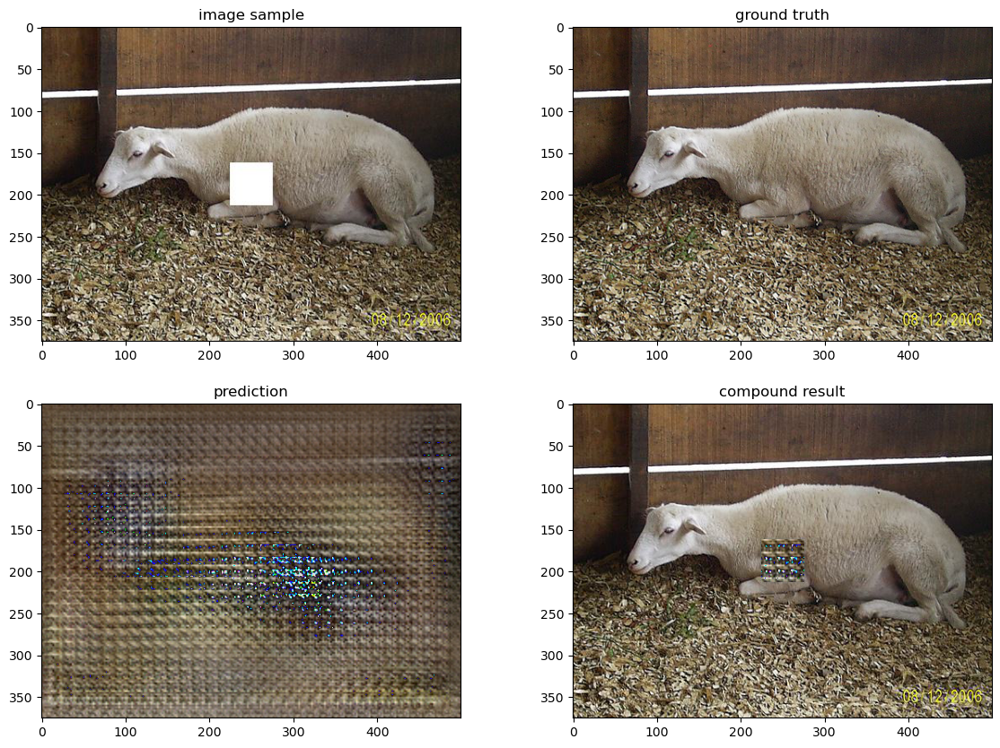

In [11]:
# switch back to evaluation mode
overfit_net.eval()

sample_img2, sample_target2 = JointToTensor()(*sample2)
if USE_GPU:
    sample_img2 = sample_img2.cuda()
sample_output_O2 = overfit_net.forward(sample_img2[None]).squeeze(0)
# Plot!
plot_4(sample_img2, sample_target2, sample_output_O2, HOLE_SIZE)

### We can see that even through DIP didn't do a very job on the first picked image, it did somewhat a good job on the second image which captured the color of the sheep. One possible reason why the first image didn't work very well is because it have many colors and pattern in the image and for our simple network, it's too hard to capture them all. Another guess is that the second image is larger than the first, so DIP may work better for small hole rather than larger hole.

### I also tried to use some more advanced network such as Unet, but for some reason, it performed even worse. It learned the shape of the hole in just a few iterations and when we need it to fix the image, it will give the hole back. (see below)

<img src="images\DIP_Unet.png"> 

### This method is also too random, I tried to run this for serval time and sometimes I can get pretty good result (see below), but sometimes I get terrible result.
<img src="images\DIP_GoodResult.png"> 

# Auto Encoder Decoder

### This method is mentioned during L12, the idea is similar to what we got for segementation which involes using a "bottleneck", and pushing the data through the "bottleneck" to keep onluy important information. 

### The method we used can be roughly describe as follows:
### 1. We design a network.
### 2. We train the network based on all the training set images. The loss we used is L2loss. The optimizer is SGD.
### 3. Then based on the trained network, we do a forward path to get the image and fix the hole.

### Some detailed methodology can be found from "*Context Encoders: Feature Learning by Inpainting*” by D. Pathak, P. Krahenbuhl, J. Donahue, T. Darrell, A. Efros, CVPR 2016.

### For AE, we use the netwotk MyUNet.

### We again define the optimizer and training function for this section.

In [12]:
def get_optimizer_AE(net):
    optimizer = torch.optim.SGD(net.parameters(), lr=0.1, momentum=0.5)
    return optimizer

def train_AE(train_loader, net, optimizer, loss_graph):
    
    for i, data in enumerate(train_loader):
                
        inputs, masks = data

        if USE_GPU:
            inputs, masks = inputs.cuda(), masks.cuda()
            net = net.cuda()
            
        optimizer.zero_grad()
        loss,lfinal = net.forward(inputs, masks)
        loss.backward()
        optimizer.step()

        main_loss = loss.item()
        
        loss_graph.append(loss.item()) #Populate this list to graph the loss
        
    return main_loss,lfinal

### The we prepare the transformation.

In [13]:
sanity_joint_transform = JointCompose((JointToTensor(),JointNormalize(*norm)))

train_joint_transform = JointCompose((JointResizeCenterCrop(150),JointToTensor(),JointNormalize(*norm)))

val_joint_transform = JointCompose((JointToTensor(),JointNormalize(*norm)))

# Apply the Joint-Compose transformations above to create three datasets and the corresponding Data-Loaders.
# This cell is fully implemented.

# This single image data(sub)set can help to better understand and to debug the network training process. 
# Optional integer parameter 'sanity_check' specifies the index of the image-target pair and creates a single image dataset.
# Note that we use the same image (index=200) as used for sample1.
sanity_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'train',
    transforms = sanity_joint_transform,
    sanity_check = 100
)

# This is a standard VOC data(sub)set used for training semantic segmentation networks
train_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'train', 
    transforms = train_joint_transform
)

# This is a standard VOC data(sub)set used for validating semantic segmentation networks
val_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set='val',
    transforms = val_joint_transform
)

sanity_loader = DataLoader(sanity_data, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)
train_loader = DataLoader(train_data, batch_size=TRAIN_BATCH_SIZE, num_workers=NUM_WORKERS, shuffle=True)
val_loader = DataLoader(val_data, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)

### We have a look at how the untrained network.

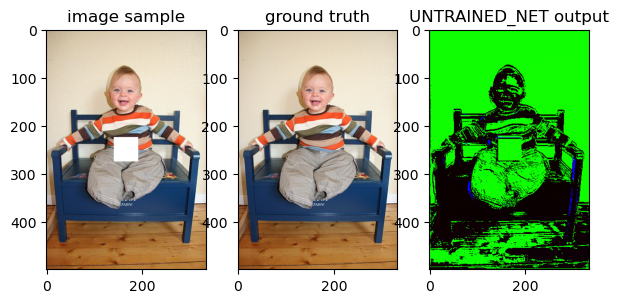

In [14]:
untrained_net = MyUNet(50).eval()
sample_img, sample_target = JointNormalize(*norm)(*JointToTensor()(*sample1))
untrained_output = untrained_net.forward(sample_img[None]).squeeze(0)

fig = plt.figure(figsize=(7,5))
ax = fig.add_subplot(1,3,1)
plt.title('image sample')
ax.imshow(sample1[0])
ax = fig.add_subplot(1,3,2)
plt.title('ground truth')
ax.imshow(sample1[1])
ax = fig.add_subplot(1,3,3)
plt.title('UNTRAINED_NET output')
ax.imshow(tF.to_pil_image(untrained_output))

### We first train on a single image to see the best we can get.

Starting Training...
Epoch: 0 Loss: 1.8481425046920776
Epoch: 100 Loss: 0.015769459307193756
Epoch: 200 Loss: 0.011594250798225403
Epoch: 300 Loss: 0.009909476153552532
Epoch: 400 Loss: 0.008255169726908207
Epoch: 500 Loss: 0.007866699248552322
Epoch: 600 Loss: 0.006981921382248402
Epoch: 700 Loss: 0.0064497157000005245
Epoch: 800 Loss: 0.006267016287893057
Epoch: 900 Loss: 0.00578314671292901
Epoch: 999 Loss: 0.005398760084062815
CPU times: total: 11min 56s
Wall time: 2min 30s


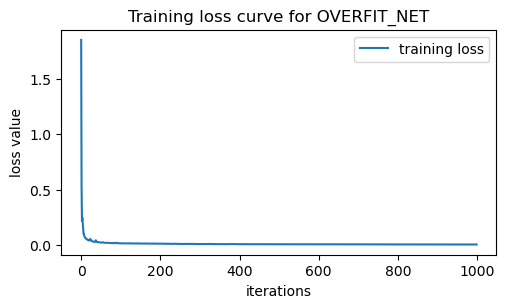

In [15]:
%%time
%matplotlib inline

# Get the net
overfit_net = copy.deepcopy(untrained_net)
# Set loss function for the net
overfit_net.criterion = nn.MSELoss()
#Set the number of EPOCHS
EPOCH = 1000
# Switch to train mode
overfit_net.train()
# Get the optimizer
optimizer = get_optimizer_AE(overfit_net)

loss_graph = []

fig = plt.figure(figsize=(6,3))
plt.subplots_adjust(bottom=0.2,right=0.85,top=0.95)
ax = fig.add_subplot(1,1,1)

print("Starting Training...")
for e in range(EPOCH):
    loss, lfinal = train_AE(sanity_loader, overfit_net, optimizer, loss_graph)
    ax.clear()
    ax.set_xlabel('iterations')
    ax.set_ylabel('loss value')
    ax.set_title('Training loss curve for OVERFIT_NET')
    ax.plot(loss_graph, label='training loss')
    ax.legend(loc='upper right')
    fig.canvas.draw()
    if e % (EPOCH//10) == 0 or e == EPOCH - 1:
        print("Epoch: {} Loss: {}".format(e, loss))

#### We see if it worked good of the overfit net.

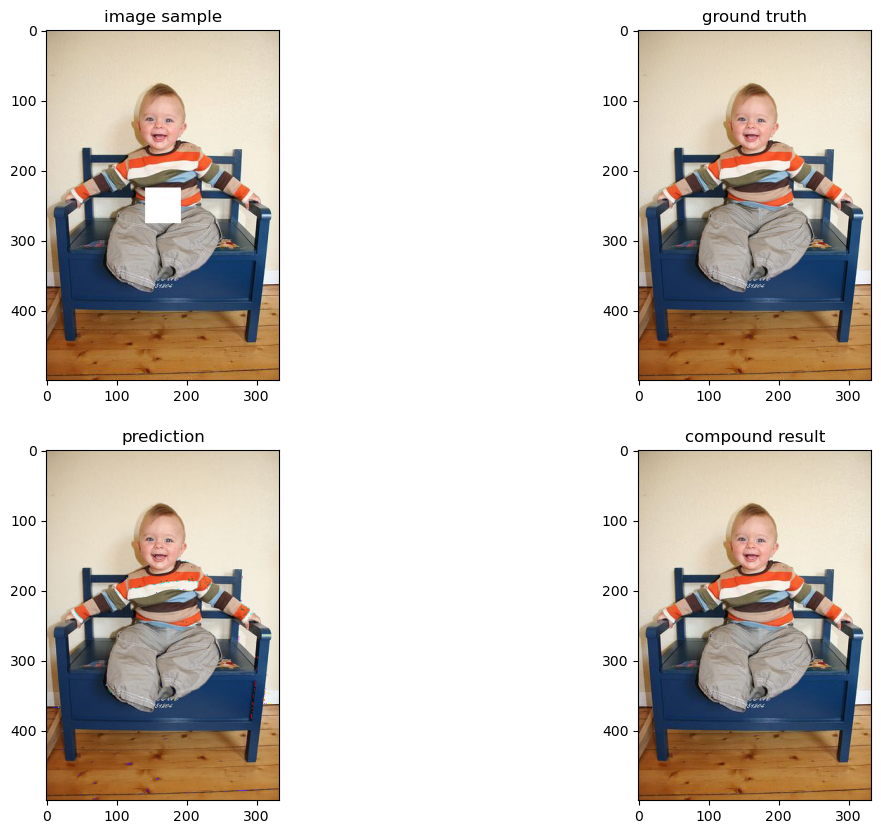

In [16]:
# switch back to evaluation mode
overfit_net.eval()

sample_img_over1, sample_target_over1 = JointNormalize(*norm)(*JointToTensor()(*sample1))
if USE_GPU:
    sample_img_over1 = sample_img_over1.cuda()
sample_output_O_over1 = overfit_net.forward(sample_img_over1[None]).squeeze(0)
# Plot!
plot_4(sample_img_over1, sample_target_over1, sample_output_O_over1, HOLE_SIZE, invnorm=True)


### We can see it's preforming very well, it caputured all the feature of the true image.

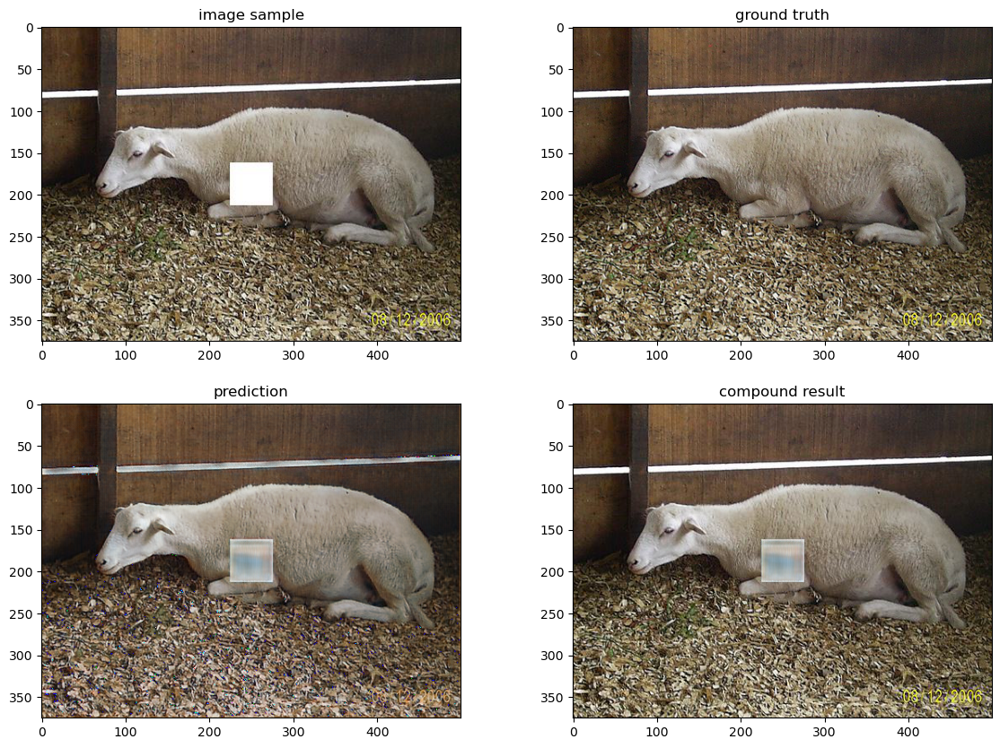

In [17]:
sample_img_over2, sample_target_over2 = JointNormalize(*norm)(*JointToTensor()(*sample2))
if USE_GPU:
    sample_img_over2 = sample_img_over2.cuda()
sample_output_O_over2 = overfit_net.forward(sample_img_over2[None]).squeeze(0)
# Plot!
plot_4(sample_img_over2, sample_target_over2, sample_output_O_over2, HOLE_SIZE, invnorm= True)

### Meanwhile on a image it didn't see, it performed less satisfactory.

### We compare the effect of the overfit net for both training set and testing set.

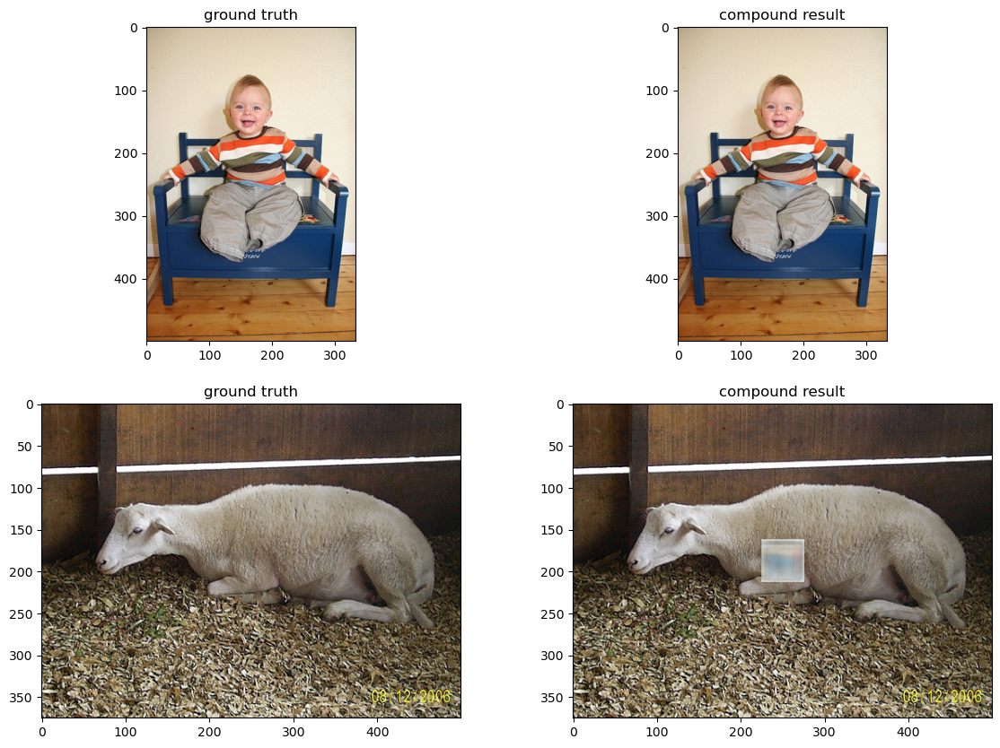

In [18]:
plot_compare(sample_target_over1, sample_output_O_over1, sample_target_over2, sample_output_O_over2, HOLE_SIZE, invnorm= True)

### Now we train on the whole training set.

Starting Training...
Epoch: 0 Loss: 0.14115141332149506
Epoch: 50 Loss: 0.0314825139939785
Epoch: 100 Loss: 0.032833367586135864
Epoch: 150 Loss: 0.03186724707484245
Epoch: 200 Loss: 0.04126833751797676
Epoch: 250 Loss: 0.015405209735035896
Epoch: 300 Loss: 0.0199789609760046
Epoch: 350 Loss: 0.032014913856983185
Epoch: 400 Loss: 0.02882104180753231
Epoch: 450 Loss: 0.020791536197066307
Epoch: 499 Loss: 0.021584197878837585
CPU times: total: 20h 8min 5s
Wall time: 4h 23min 2s


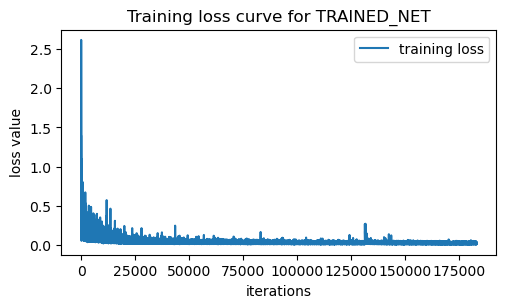

In [19]:
%%time
%matplotlib inline

# Get the net
trained_net = copy.deepcopy(untrained_net)
# Set loss function for the net
trained_net.criterion = nn.MSELoss()
# Se the number of EPOCHS
EPOCH = 500
# Switch to train mode
trained_net.train()
# Get the optimizer
optimizer = get_optimizer_AE(trained_net)

loss_graph = []

fig = plt.figure(figsize=(6,3))
plt.subplots_adjust(bottom=0.2,right=0.85,top=0.95)
ax = fig.add_subplot(1,1,1)

print("Starting Training...")
for e in range(EPOCH):
    loss, lfinal = train_AE(train_loader, trained_net, optimizer, loss_graph)
    ax.clear()
    ax.set_xlabel('iterations')
    ax.set_ylabel('loss value')
    ax.set_title('Training loss curve for TRAINED_NET')
    ax.plot(loss_graph, label='training loss')
    ax.legend(loc='upper right')
    fig.canvas.draw()
    if e % (EPOCH//10) == 0 or e == EPOCH - 1:
        print("Epoch: {} Loss: {}".format(e, loss))

### We still got pretty good result!

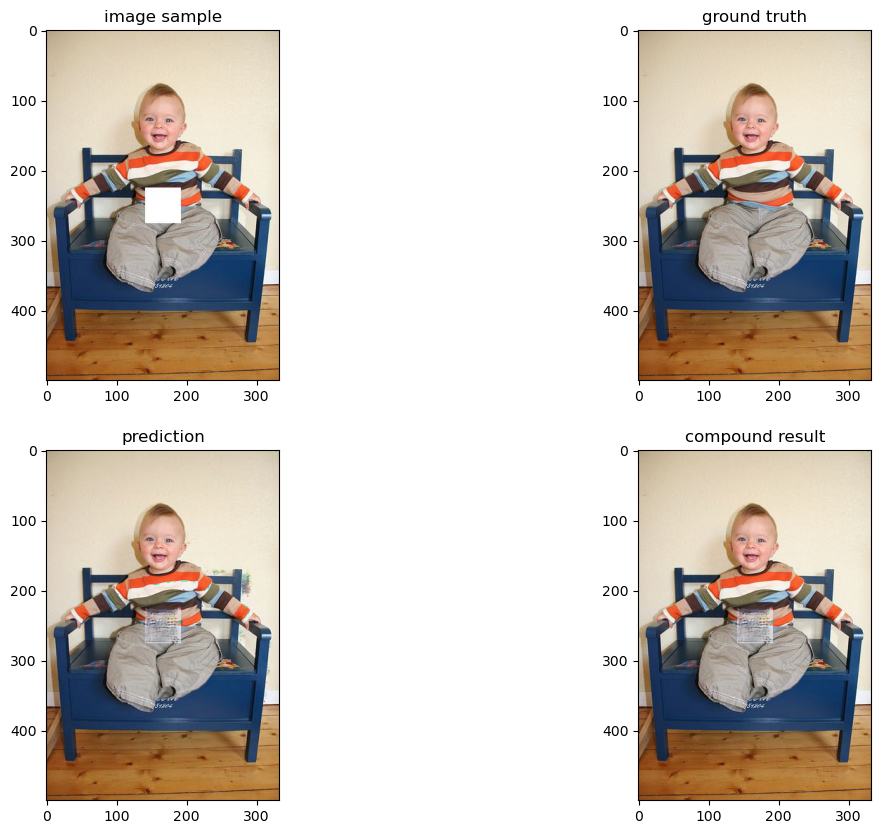

In [20]:
# switch back to evaluation mode
trained_net.eval()

sample_img1, sample_target1 = JointNormalize(*norm)(*JointToTensor()(*sample1))
if USE_GPU:
    sample_img1 = sample_img1.cuda()
sample_output_T1 = trained_net.forward(sample_img1[None]).squeeze(0)
# Plot!
plot_4(sample_img1, sample_target1, sample_output_T1, HOLE_SIZE, invnorm= True)

### We can see that the color is correct even for the validation set, which is very good! We got quite satisfying result from Auto Encoder!

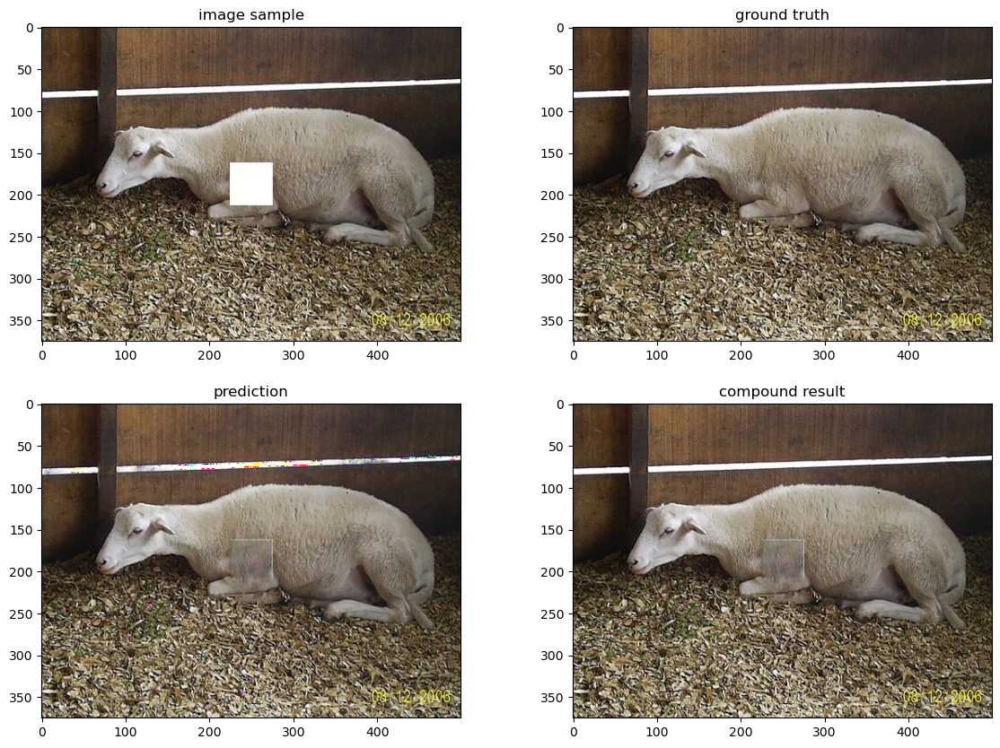

In [21]:
sample_img2, sample_target2 = JointNormalize(*norm)(*JointToTensor()(*sample2))
if USE_GPU:
    sample_img2 = sample_img2.cuda()
sample_output_T2 = trained_net.forward(sample_img2[None]).squeeze(0)
# Plot!
plot_4(sample_img2, sample_target2, sample_output_T2, HOLE_SIZE, invnorm= True)

### We compare the result we got from the training set and the validation set.

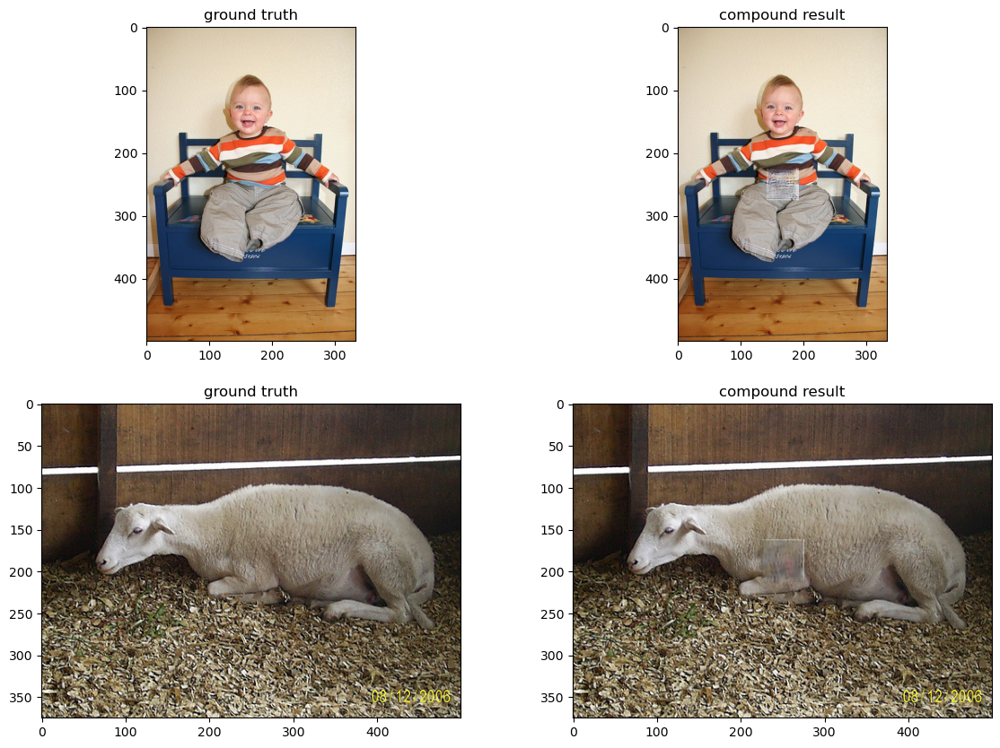

In [22]:
plot_compare(sample_target1, sample_output_T1, sample_target2, sample_output_T2, HOLE_SIZE, invnorm= True)

# GAN

### This method is mentioned during L12, the idea is that we have two networks and we train them to compete each other, one network is the generator which generate inpainted image, the other network is the discriminator which tries to tell if the input image is fake or not.

### The method we used can be roughly describe as follows:
### 1. We design a generator network and a discriminator network.
### 2. We train the network based on all the training set images. We give the discriminator network the real image and the generated image in each EPOCH and train the discriminator based on the loss. Wwe train the generator based on the loss from discriminator network as well. The loss we used is Binary Corss Entropy loss. The optimizer is still SGD.
### 3. Then based on the trained network, we do a forward path to get the image and fix the hole.

### The implementation is based heavily on this pytorch tutorial https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

### For GAN, we use the netwotk MyUNet for generator and MyDis (which is basiclly Resnet18) for discriminator.

### Still, define the optimizer and training function for GAN.

In [ ]:
def get_optimizer_gan(net):
    optimizer = torch.optim.SGD(net.parameters(), lr=0.001, momentum=0.5)
    return optimizer


def train_gan(train_loader, gen_net, dis_net, gen_optimizer, dis_optimizer, gen_loss_graph, dis_loss_graph):
    for i, data in enumerate(train_loader):

        inputs, masks = data
        fake_label = torch.full((inputs.size(0),1), 0.0, dtype=torch.float)
        true_label = torch.full((inputs.size(0),1), 1.0, dtype=torch.float)
        if USE_GPU:
            inputs, masks, fake_label, true_label = inputs.cuda(), masks.cuda(), fake_label.cuda(), true_label.cuda()
            gen_net = gen_net.cuda()
            dis_net = dis_net.cuda()

        # for the dis part
        # train for fake data
        gen_net.eval()
        lfinal = gen_net.forward(inputs)
        gen_net.train()

        dis_optimizer.zero_grad()
        dis_loss_fake, result = dis_net.forward(lfinal.detach(),fake_label) # 0 is fake, 1 is real
        dis_loss_fake.backward()
        # train for real data
        dis_loss_true, result = dis_net.forward(masks,true_label) # 0 is fake, 1 is real
        dis_loss_true.backward()
        dis_loss = dis_loss_true + dis_loss_fake
        dis_optimizer.step()

        # for the gen part       
        gen_optimizer.zero_grad()
        gen_loss, result= dis_net.forward(lfinal,true_label) # 0 is fake, 1 is real
        gen_loss.backward()
        gen_optimizer.step()

        gen_loss = gen_loss.item()
        dis_loss = dis_loss.item()
        
        gen_loss_graph.append(gen_loss) #Populate this list to graph the loss
        dis_loss_graph.append(dis_loss) #Populate this list to graph the loss
        
    return gen_loss, dis_loss, lfinal, result

### Still, the transformation and datset.....

In [ ]:
sanity_joint_transform = JointCompose((JointToTensor(),JointNormalize(*norm)))

train_joint_transform = JointCompose((JointResizeCenterCrop(150),JointToTensor(),JointNormalize(*norm)))

val_joint_transform = JointCompose((JointToTensor(),JointNormalize(*norm)))

sanity_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'train',
    transforms = sanity_joint_transform,
    sanity_check = 100
)

# This is a standard VOC data(sub)set used for training semantic segmentation networks
train_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set = 'train', 
    transforms = train_joint_transform
)

# This is a standard VOC data(sub)set used for validating semantic segmentation networks
val_data = VOCImpaint_midhole(
    DATASET_PATH, 
    image_set='val',
    transforms = val_joint_transform
)

sanity_loader = DataLoader(sanity_data, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)
train_loader = DataLoader(train_data, batch_size=TRAIN_BATCH_SIZE, num_workers=NUM_WORKERS, shuffle=True)
val_loader = DataLoader(val_data, batch_size=1, num_workers=NUM_WORKERS, shuffle=False)

### Train!

Starting Training...
Epoch: 0 Gen Loss: 0.7656079530715942 Dis Loss: 1.3310933113098145
Epoch: 1 Gen Loss: 0.8163408041000366 Dis Loss: 1.2677433490753174
Epoch: 2 Gen Loss: 0.7579736709594727 Dis Loss: 1.349022388458252
Epoch: 3 Gen Loss: 0.7937333583831787 Dis Loss: 1.20611572265625
Epoch: 4 Gen Loss: 0.7971844673156738 Dis Loss: 1.1450573205947876
Epoch: 5 Gen Loss: 0.9165827035903931 Dis Loss: 1.1237359046936035
Epoch: 6 Gen Loss: 1.0904009342193604 Dis Loss: 1.1490683555603027
Epoch: 7 Gen Loss: 1.1734998226165771 Dis Loss: 1.080697774887085
Epoch: 8 Gen Loss: 1.5529166460037231 Dis Loss: 0.5111427307128906
Epoch: 9 Gen Loss: 1.1531672477722168 Dis Loss: 0.8892278671264648
Epoch: 10 Gen Loss: 2.3820648193359375 Dis Loss: 0.15960924327373505
Epoch: 11 Gen Loss: 2.5532145500183105 Dis Loss: 0.17044410109519958
Epoch: 12 Gen Loss: 2.085930824279785 Dis Loss: 1.1204220056533813
Epoch: 13 Gen Loss: 3.0574896335601807 Dis Loss: 0.22861172258853912
Epoch: 14 Gen Loss: 2.9642333984375 Dis

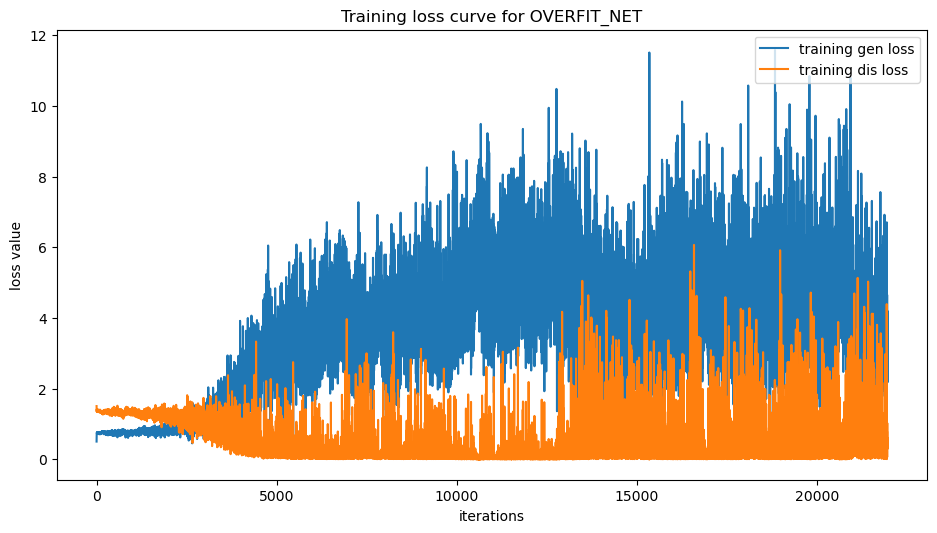

In [ ]:
%%time
%matplotlib inline

# Get the nets
trained_gen_net = MyUNet(50)
trained_dis_net = MyDis(BATCH_SIZE = TRAIN_BATCH_SIZE)
# Set loss function for the net
trained_gen_net.criterion = nn.MSELoss() # note we didn't use this loss for gan
trained_dis_net.criterion = nn.BCELoss()
# Switch to train mode
trained_gen_net.train()
trained_dis_net.train()
# Set the number of EPOCHS
EPOCH = 60
# Get the optimizer
gen_optimizer = get_optimizer_gan(trained_gen_net)
dis_optimizer = get_optimizer_gan(trained_dis_net)

gen_loss_graph = []
dis_loss_graph = []

fig = plt.figure(figsize=(12,6))
plt.subplots_adjust(bottom=0.2,right=0.85,top=0.95)
ax = fig.add_subplot(1,1,1)

print("Starting Training...")
for e in range(EPOCH):
    gen_loss, dis_loss, lfinal, result = train_gan(train_loader, trained_gen_net, trained_dis_net, gen_optimizer, dis_optimizer, gen_loss_graph, dis_loss_graph)
    ax.clear()
    ax.set_xlabel('iterations')
    ax.set_ylabel('loss value')
    ax.set_title('Training loss curve for OVERFIT_NET')
    ax.plot(gen_loss_graph, label='training gen loss')
    ax.plot(dis_loss_graph, label='training dis loss')
    ax.legend(loc='upper right')
    fig.canvas.draw()
    print("Epoch: {} Gen Loss: {} Dis Loss: {}".format(e, gen_loss, dis_loss))

### It looks very bad! It only catpured some basic feature and it didn't capture the color at all. But what if it's only bad in the training set?

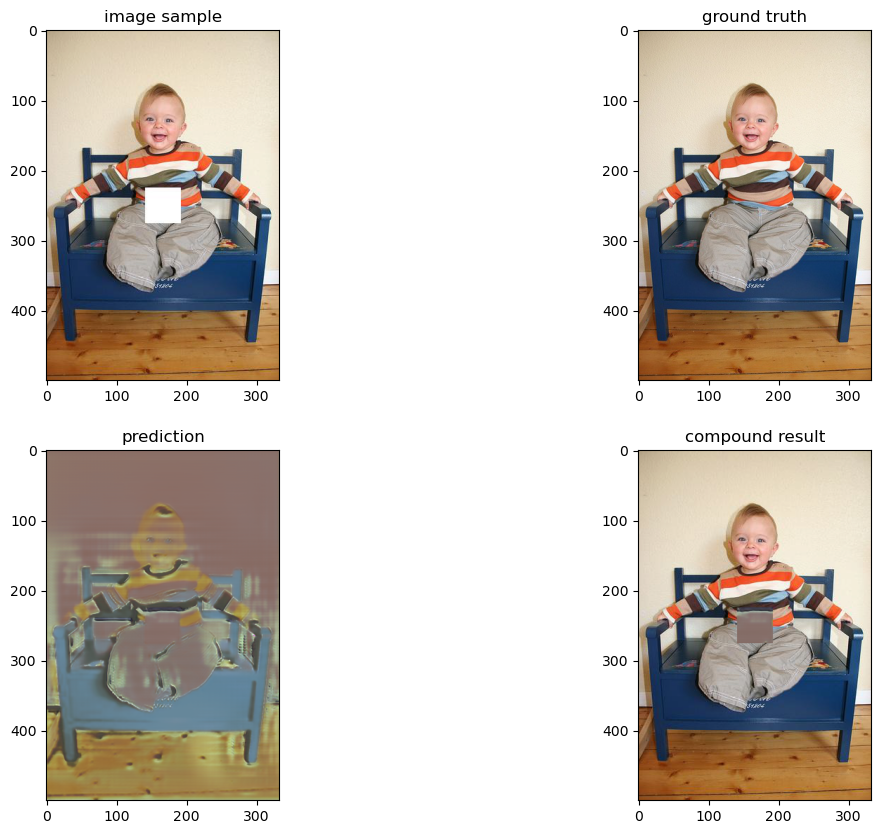

In [ ]:
# switch back to evaluation mode
trained_gen_net.eval()

sample_img1, sample_target1 = JointNormalize(*norm)(*JointToTensor()(*sample1))
if USE_GPU:
    sample_img1 = sample_img1.cuda()
sample_output_T1 = trained_gen_net.forward(sample_img1[None]).squeeze(0)
# Plot!
plot_4(sample_img1, sample_target1, sample_output_T1, HOLE_SIZE, invnorm= True)

### The validation set is also bad.... But we can observe some intesting things here, the GAN captured the edges quite well.

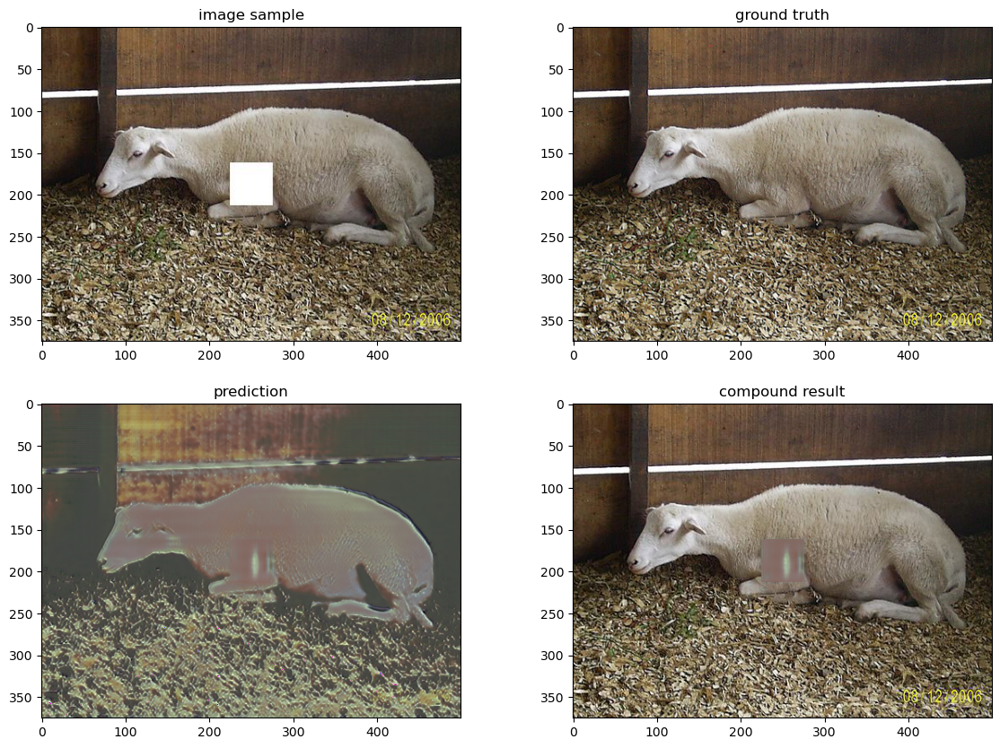

In [ ]:
sample_img2, sample_target2 = JointNormalize(*norm)(*JointToTensor()(*sample2))
if USE_GPU:
    sample_img2 = sample_img2.cuda()
sample_output_T2 = trained_gen_net.forward(sample_img2[None]).squeeze(0)
# Plot!
plot_4(sample_img2, sample_target2, sample_output_T2, HOLE_SIZE, invnorm= True)

### Another validation image to see if it's really that bad. And yes, it is.....

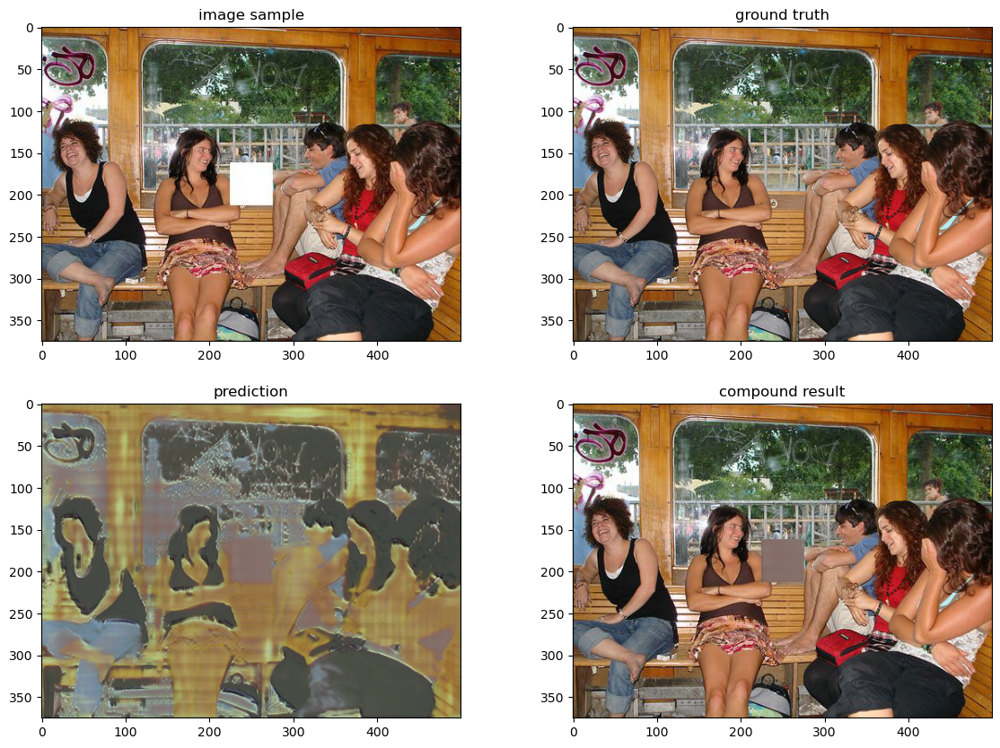

In [ ]:
sample3 = VOCImpaint_midhole(DATASET_PATH, image_set='val', make_hole = False, size = HOLE_SIZE)[35]

# switch back to evaluation mode
trained_gen_net.eval()

sample_img3, sample_target3 = JointNormalize(*norm)(*JointToTensor()(*sample3))
if USE_GPU:
    sample_img3 = sample_img3.cuda()
sample_output_T3 = trained_gen_net.forward(sample_img3[None]).squeeze(0)
# Plot!
plot_4(sample_img3, sample_target3, sample_output_T3, HOLE_SIZE, invnorm= True)

### The reasons why the GAN method didn't work great my have something to do with the size of the dataset. We have too few dataset compared to the number of features that we are trying to make our network to learn.
### When I increased the number of EPOCH, the network become more and more chaotic and finally became random even for taring set! (see below for some example) Comparing this massive pattern, feature and color to the tutorial on pytorch which only focused on faces. We indeed have too small of a dataset. 
<img src="images\GAN_Overtrain.png">  <img src="images\GAN_Overtrain2.png"> 

### When I decreased the number of EPOCH, GAN captured the shape somewhat better (see below for the compare between train and val).
<img src="images\GAN_SomewhatBetter_train.png">  <img src="images\GAN_SomewhatBetter_val.png"> 

### Moreover, we can see that the both the generator and the discriminator did not converge. So this confirmed that we have some too complicated pattern for GAN to fit.

# We have a winner!

### We can see that Auto Encoder Decoder worked the best. Let's see if our winner is really that reliable for all validation set.

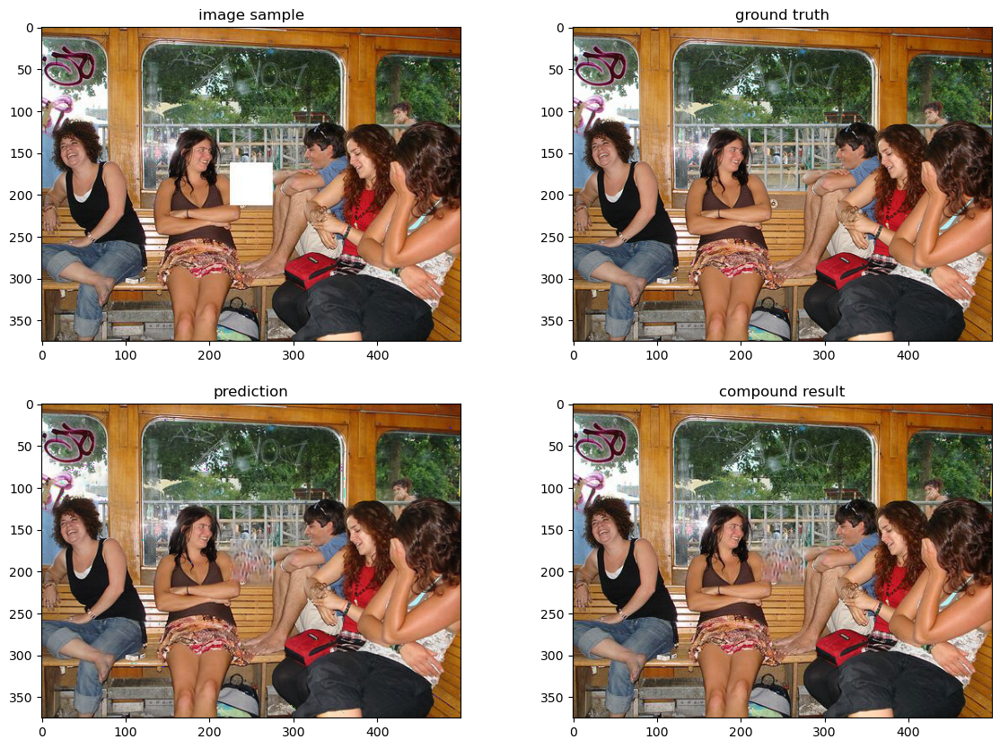

In [23]:
sample3 = VOCImpaint_midhole(DATASET_PATH, image_set='val', make_hole = False, size = HOLE_SIZE)[35]

# switch back to evaluation mode
trained_net.eval()

sample_img3, sample_target3 = JointNormalize(*norm)(*JointToTensor()(*sample3))
if USE_GPU:
    sample_img3 = sample_img3.cuda()
sample_output_T3 = trained_net.forward(sample_img3[None]).squeeze(0)
# Plot!
plot_4(sample_img3, sample_target3, sample_output_T3, HOLE_SIZE, invnorm= True)

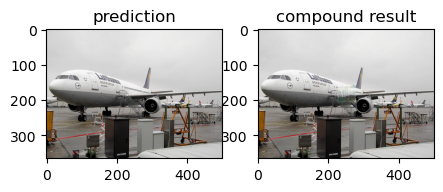

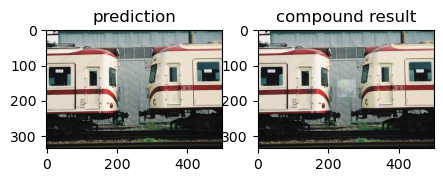

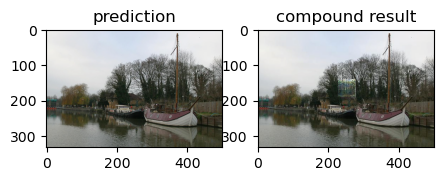

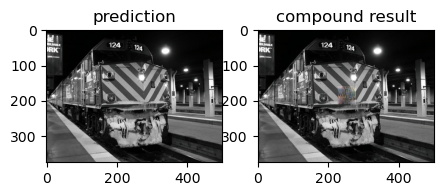

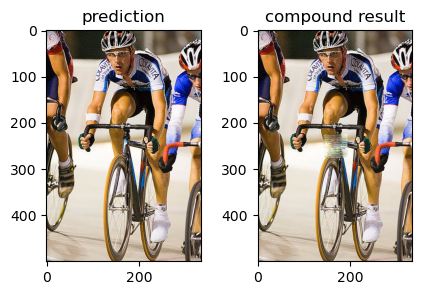

...

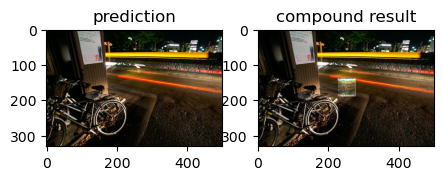

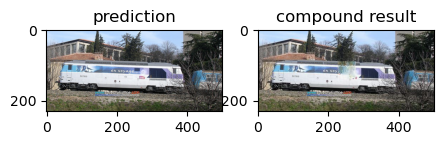

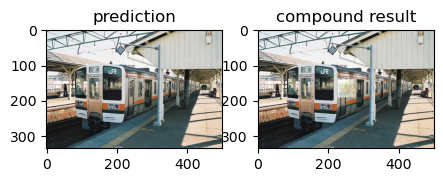

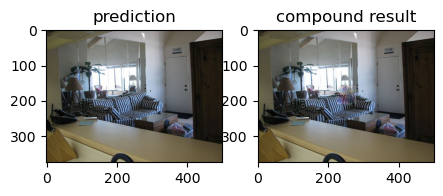

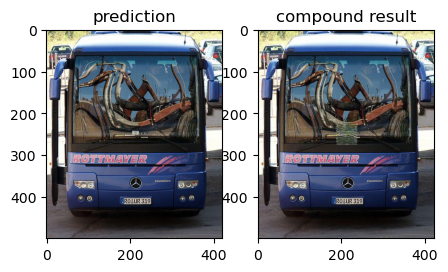

In [ ]:
for i in range(20):    
    samplei = VOCImpaint_midhole(DATASET_PATH, image_set='val', make_hole = False, size = HOLE_SIZE)[i]

    # switch back to evaluation mode
    trained_net.eval()

    sample_imgi, sample_targeti = JointNormalize(*norm)(*JointToTensor()(*samplei))
    if USE_GPU:
        sample_imgi = sample_imgi.cuda()
    sample_output_Ti = trained_net.forward(sample_imgi[None]).squeeze(0)
    # Plot!
    plot_2(sample_imgi, sample_targeti, sample_output_Ti, HOLE_SIZE, invnorm= True)

### It's very good!

# Conclusion

### We can clearly see that Auto Encoder worked great and seems to solved our probelm. But we still have that blurryness if we are using some high resolution image. So if we can expand our dataset to even larger, GAN might be a better idea.

### Some probelms and potential improvement for this project that I wish to adress but due to the time and hardware, I couldn't:
### 1. We didn't use any criteria to decide or quantify each model, all we did is to pick the same image and made decision based on that very image. This is a very bad thing to do and could lead to bias. The reason I didn't use any criteria is because I didn't come up with any. One naive approach would be to compare the color difference pixel by pixel between the fitted one and the real one and give some threshold of the difference. But this method didn’t take edge into account, the criteria should look at a bigger picture, it should take the shape and such into account.
### 2. For DIP, we could try smaller hole size and I believe there will be a significant improvement.
### 3. For Auto Encoder Decoder, inspired by DIP, maybe we should treat the loss from the hole less?
### 4. For GAN, we could use a bigger dataset.
### 5. The current GAN Loss focused only on the discriminator's Cross Entropy Loss and didn't focus on the L2 Loss from the generator (this means to aid the loss by color which is the probelm of GAN), maybe combining these Loss in some sense could help.